# The Bipartite Network of Climbers and Routes


In [3]:
import pandas as pd
import numpy as np
import missingno as msn
import seaborn as sns
import datetime
from itertools import product
from bicm import BipartiteGraph

import networkx as nx
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt 
from scipy.sparse import csr_matrix

## Data

Before modeling we first will take a look at the data we are working with. The scraping process can be viewed here https://github.com/AndreaVisma/climbing-history

In [4]:
df = pd.read_excel('data/climbing_history_all_cleanish.xlsx')

In [5]:
display(df.info())
display(df.head(5))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10476 entries, 0 to 10475
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Climber          10476 non-null  object
 1   Style            10476 non-null  object
 2   Ascent Date      9165 non-null   object
 3   Suggested Grade  1197 non-null   object
 4   link             10476 non-null  object
 5   Route            10476 non-null  object
 6   Official grade   10476 non-null  object
 7   parsed_dates     8945 non-null   object
dtypes: object(8)
memory usage: 654.9+ KB


None

,Climber,Style,Ascent Date,Suggested Grade,link,Route,Official grade,parsed_dates
0,James Pearson,Boulder | worked,5th Sep 2006,NaN,/climb/167/keen-roof,Keen Roof,8a+,05-09-2006
1,Dave Nodden,Boulder | worked,May 2009,NaN,/climb/167/keen-roof,Keen Roof,8a+,19-05-2009
2,Ignacio Sánchez González,Boulder | worked,4th May 2009,NaN,/climb/167/keen-roof,Keen Roof,8a+,04-05-2009
3,Rupert Davies,Boulder | worked,8th May 2010,NaN,/climb/167/keen-roof,Keen Roof,8a+,08-05-2010
4,Dawid Skoczylas,Boulder | worked,11th Sep 2010,NaN,/climb/167/keen-roof,Keen Roof,8a+,11-09-2010


In [6]:
print("Number of unique climbers: ", len(df['Climber'].unique()))
print("Number of unique routes: ", len(df['Route'].unique()))

Number of unique climbers:  1757
Number of unique routes:  3820


In [7]:
print(df['Style'].unique())

['Boulder | worked' 'Boulder | flash' 'Lead | worked' 'Lead | onsight'
 'Lead | did not finish' 'Aid | worked' 'Aid | repeat' 'Simul | worked'
 'Rope Solo | worked' 'Lead | ground up' 'Aid' 'Solo | worked'
 'Lead | flash' 'Top Rope | flash' 'Boulder | did not finish'
 'Lead | yo-yo' 'Lead' 'Lead | repeat' 'Boulder | ground up' 'Boulder'
 'Solo | repeat' 'Solo | onsight' 'Alternate Leads | worked'
 'Solo | did not finish' 'Solo | flash' 'Deep Water Solo | worked'
 'Deep Water Solo | did not finish' 'Top Rope | worked'
 'Alternate Leads | flash' 'Boulder | repeat' 'Solo | ground up'
 'Deep Water Solo | repeat' 'Deep Water Solo | ground up'
 'Alternate Leads | ground up' 'Alternate Leads'
 'Deep Water Solo | onsight' 'Deep Water Solo | flash'
 'Alternate Leads | onsight' 'Solo' 'Rope Solo | onsight'
 'Alternate Leads | alpine' 'Second | onsight' 'Top Rope | repeat'
 'Lead | pre-placed gear' 'Simul | onsight' 'Top Rope | did not finish'
 'Second' 'Deep Water Solo' 'Mountaineering | expedit

In [8]:
style = []
weight = []

for style_weight in df['Style']:
    if '|' in style_weight:
        style_weight_split = style_weight.split('|')
        style.append(style_weight_split[0].strip())
        weight.append(style_weight_split[1].strip())
    else:
        style.append(style_weight_split[0].strip())
        weight.append(np.nan)

df['climbing_style'] = style
df['weight'] = weight

df.rename(columns={
    'Climber': 'climber', 
    'Official grade': 'official_grade',
    'Route' : 'route',
    'Suggested Grade' : 'suggested_grade',
    'Ascent Date' : 'ascent_date'},
    inplace=True)

df = df.drop(['Style'], axis=1)
df['date'] = pd.to_datetime(df['parsed_dates'], format='mixed', errors='coerce')


We want to have a consistent grading system. We will have an unique grading system for Aid and Mountaineering and for Bouldering, Lead, Solo etc. we will be using the french grading system.

In [9]:
print(df['official_grade'].unique())

['8a+' '8b' '8c' '8b+' '9a' 'e9' 'e8' '7c' '9a+' 'e10' '8c+' 'e7' '8a'
 'e5' '9b' '7b' 'e6' '7c+' 'e11' 'e3' '9b+' 'e1' 'ed2' 'e2' 'ed1' 'e4'
 '7b+' '8b+ (approx)' 'e12' '7a' '8b (approx)' 'ed3' '9c' 'hvs' '7a+' 'hs'
 '6c' 'a4' 'e9 (approx)' '9a (approx)' '6c+' '6a' 'vs' 'vd' 'f-' 'd' 'td+'
 'e10 (approx)' 'a3' '8c+ (approx)' '6b' '9c (approx)' 'td' '6b+'
 'hs (approx)' '5+' '3' '9a+ (approx)' '8a (approx)' '9b (approx)'
 '7c (approx)' '9b+ (approx)']


In [10]:
grade_mapping = {
                "vd" : "4a",
                "s" : "4b",
                "hs" : "4c",
                "vs" : "5a",
                "hvs" : "5b",
                "e1" : "5c",
                "e2" : "6a+",
                "e3" : "6b+",
                "e4" : "6c+",
                "e5" : "7a+",
                "e6" : "7b+",
                "e7" : "7c+",
                "e8" : "8a+",
                "e9" : "8b",
                "e10" : "8b+",
                "e11" : "8c+",
                "e12" : "9a",
                "5+" : "5c"    
                }

In [11]:
df['official_grade_consistent'] = df['official_grade'].str.replace(" (approx)", "", regex=False)
df['official_grade_consistent'] = df['official_grade_consistent'].replace(grade_mapping)

In [12]:
display(df.head(5))

,climber,ascent_date,suggested_grade,link,route,official_grade,parsed_dates,climbing_style,weight,date,official_grade_consistent
0,James Pearson,5th Sep 2006,NaN,/climb/167/keen-roof,Keen Roof,8a+,05-09-2006,Boulder,worked,2006-05-09,8a+
1,Dave Nodden,May 2009,NaN,/climb/167/keen-roof,Keen Roof,8a+,19-05-2009,Boulder,worked,2009-05-19,8a+
2,Ignacio Sánchez González,4th May 2009,NaN,/climb/167/keen-roof,Keen Roof,8a+,04-05-2009,Boulder,worked,2009-04-05,8a+
3,Rupert Davies,8th May 2010,NaN,/climb/167/keen-roof,Keen Roof,8a+,08-05-2010,Boulder,worked,2010-08-05,8a+
4,Dawid Skoczylas,11th Sep 2010,NaN,/climb/167/keen-roof,Keen Roof,8a+,11-09-2010,Boulder,worked,2010-11-09,8a+


In [13]:
display(df[df['climbing_style']=='Boulder']['official_grade_consistent'].unique())
display(df[df['climbing_style']=='Lead']['official_grade_consistent'].unique())

array(['8a+', '8b', '8b+', '8c', '7c', '8c+', '9a', '8a', '7b', '7c+',
       '7a+', '6b+', 'ed1', '6c+', '6c', 'a4', '6a+', '7b+', '6a', '5c',
       '5a', '7a', '6b', '9a+', '3', '5b', '4a', '9b'], dtype=object)

array(['8c', '8b+', '9a', '8b', '8a+', '7c', '9a+', '8c+', '7c+', '8a',
       '7a+', '9b', '7b+', '6b+', '9b+', '5c', '6a+', '6c+', '7a', 'ed3',
       '9c', '5b', '4c', '7b', 'a4', '4a', 'a3', '5a', '6b', '6c'],
      dtype=object)

In [14]:
display(df[(df['climbing_style']=='Lead') & (df['official_grade_consistent']=='ed3')])

,climber,ascent_date,suggested_grade,link,route,official_grade,parsed_dates,climbing_style,weight,date,official_grade_consistent
6300,Jean-Cristophe Lafaille,Between 12th Feb 2001 and 21st Feb 2001,NaN,/climb/3839/lafaille-route,Lafaille Route,ed3,NaN,Lead,NaN,NaT,ed3
6301,Andy Kirkpatrick,Feb 2003,NaN,/climb/3839/lafaille-route,Lafaille Route,ed3,19-02-2003,Lead,NaN,2003-02-19,ed3
6302,Ian Parnell,Feb 2003,NaN,/climb/3839/lafaille-route,Lafaille Route,ed3,19-02-2003,Lead,NaN,2003-02-19,ed3


Since we are focusing on Boulder and Lead, I only looked at their unique official grades. Through that I found some routes that we wrongly classified:
- Central Pillar Of Freney (Mountaineering, grade ED, source https://www.planetmountain.com/en/routes/the-central-pillar-of-freney-british-route-mont-blanc.html)
- Atlantic Ocean Wall (Aid, grade A4, https://www.mountainproject.com/route/123613063/atlantic-ocean-wall)
- Lafaille Route (Aid or Mountaineering?, grade ED3, source https://climbing-history.org/climb/3839/lafaille-route )
- Flight Of The Albatross (Aid, grad A4, source https://climbing-history.org/climb/3500/flight-of-the-albatross)
- Zenyatta Mondatta (Aid, grade A3, source https://www.mountainproject.com/route/106150461/zenyatta-mondatta)


In [15]:
df.loc[df['route'] == 'Central Pillar Of Freney', 'climbing_style'] = 'Mountaineering'
df.loc[df['route'] == 'Atlantic Ocean Wall', 'climbing_style'] = 'Aid'
df.loc[df['route'] == 'Lafaille Route', 'climbing_style'] = 'Aid'
df.loc[df['route'] == 'Flight Of The Albatross', 'climbing_style'] = 'Aid'
df.loc[df['route'] == 'Zenyatta Mondatta', 'climbing_style'] = 'Aid'

In [16]:
set(df['official_grade_consistent'].unique()) - set( ["3", "4a", "4a+", "4b", "4b+", "4c", "4c+", "5a", "5a+", "5b", "5b+", "5c", "5c+",
    "6a", "6a+", "6b", "6b+", "6c", "6c+", "7a", "7a+", "7b", "7b+", "7c", "7c+",
    "8a", "8a+", "8b", "8b+", "8c", "8c+", "9a", "9a+", "9b", "9b+", "9c", "9c+"])

{'a3', 'a4', 'd', 'ed1', 'ed2', 'ed3', 'f-', 'td', 'td+'}

### Missing values

climber                         0
ascent_date                  1311
suggested_grade              9279
link                            0
route                           0
official_grade                  0
parsed_dates                 1531
climbing_style                  0
weight                        387
date                         1533
official_grade_consistent       0
dtype: int64

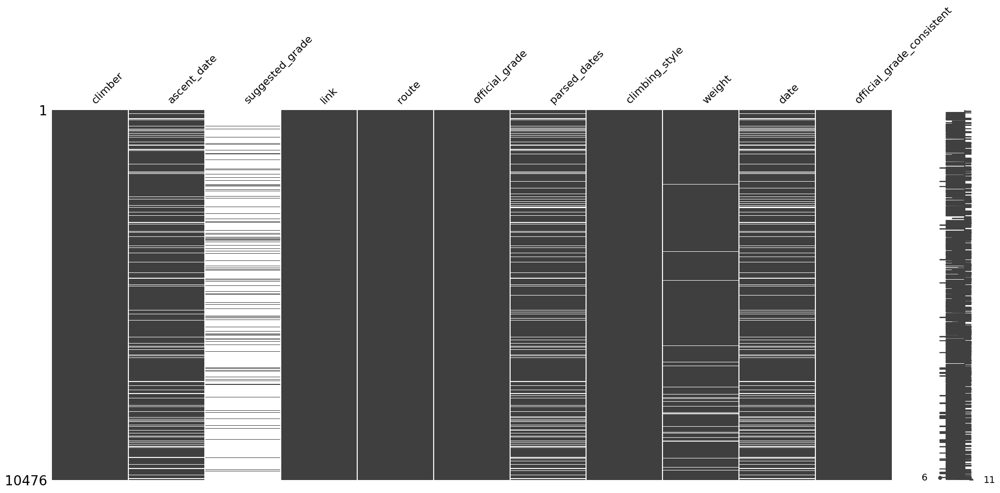

In [17]:
msn.matrix(df)
df.isna().sum()

### Exploratory Data Analysis (EDA)

(only a little bittt)

In [18]:
route_counts = df.groupby(['climber', 'climbing_style']).size().unstack(fill_value=0)
route_counts['total'] = route_counts.sum(axis=1)

top_climbers = route_counts.nlargest(25, 'total')  
route_counts = top_climbers.drop(columns='total')  

route_counts_long = route_counts.reset_index().melt(
    id_vars='climber', 
    var_name='climbing_style', 
    value_name='route_count'
)

fig = px.bar(
    route_counts_long,
    x='climber',
    y='route_count',
    color='climbing_style',
    title='Top (climbed the most) 25 Climbers',
    labels={'climber': 'Climber', 'route_count': 'Number of Routes'},
)

fig.update_layout(
    xaxis_title="Climber",
    yaxis_title="Number of Routes",
    legend_title="Climbing Type",
    xaxis=dict(tickangle=90), 
    title=dict(font=dict(size=16)),
    legend=dict(font=dict(size=10))
)

fig.show()

In [19]:
even_lighter_beige = 'rgb(247, 242, 233)'
light_beige = 'rgb(250, 240, 220)'
beige = 'rgb(213, 184, 149)'
brown = 'rgb(86, 56, 46)'
light_brown = 'rgb(113, 80, 58)'
light_green = 'rgb(168, 203, 160)'
green = 'rgb(78, 110, 77)'

# colors and order for grades
grade_order = [
    "3", "4a", "4a+", "4b", "4b+", "4c", "4c+", "5a", "5a+", "5b", "5b+", "5c", "5c+",
    "6a", "6a+", "6b", "6b+", "6c", "6c+", "7a", "7a+", "7b", "7b+", "7c", "7c+",
    "8a", "8a+", "8b", "8b+", "8c", "8c+", "9a", "9a+", "9b", "9b+", "9c", "9c+", 
    'a3', 'a4', 'd', 'ed1', 'ed2', 'ed3', 'f-', 'td', 'td+'
    ]

grade_groups = {
     "3&4": ["3", "4a", "4a+", "4b", "4b+", "4c", "4c+"],
     "5": ["5a", "5b", "5b+", "5c", "5c+"],
     "6": ["6a", "6a+", "6b", "6b+", "6c", "6c+"],
     "7": ["7a", "7a+", "7b", "7b+", "7c", "7c+"],
     "8": ["8a", "8a+", "8b", "8b+", "8c", "8c+"],
     "9": ["9a", "9a+", "9b", "9b+", "9c"],
     "rest": ['a3', 'a4', 'd', 'ed1', 'ed2', 'ed3', 'f-', 'td', 'td+']
     }

group_colors = {
    "3&4": green,
    "5": 'rgb(121,149,103)',
    "6": 'rgb(167,181,158)',
    "7": 'rgb(249,221,216)',
    "8": 'rgb(248,208,200)',
    "9": 'rgb(243,186,186)',
    "rest": brown
    }
grade_color_map = {grade: group_colors[group] for group, grades in grade_groups.items() for grade in grades}

In [20]:
route_counts = df.groupby(['climbing_style', 'official_grade']).size().unstack(fill_value=0)
#route_counts['total'] = route_counts.sum(axis=1)

route_counts_long = route_counts.reset_index().melt(
    id_vars='climbing_style', 
    var_name='official_grade', 
    value_name='route_count'
)

fig = px.bar(
    route_counts_long[route_counts_long['climbing_style'].isin(['Boulder', 'Lead'])],
    x='climbing_style',
    y='route_count',
    color='official_grade',
    color_continuous_scale='tealrose',
    title='Route Distribution',
    labels={'climbing_style': 'Climbing Type', 'route_count': 'Number of Routes'},
)

fig.update_layout(
    xaxis_title="Climbing Type",
    yaxis_title="Number of Routes",
    legend_title="Grade",
    xaxis=dict(tickangle=90), 
    title=dict(font=dict(size=16)),
    legend=dict(font=dict(size=10))
)

fig.show()


fig = px.bar(
    route_counts_long[route_counts_long['climbing_style'].isin(['Solo', 'Deep Water Solo', 'Alternate Lead'])],
    x='climbing_style',
    y='route_count',
    color='official_grade',
    color_continuous_scale='tealrose',
    title='Route Distribution',
    labels={'climbing_style': 'Climbing Type', 'route_count': 'Number of Routes'},
)
fig.update_layout(
    xaxis_title="Climbing Type",
    yaxis_title="Number of Routes",
    legend_title="Grade",
    xaxis=dict(tickangle=90), 
    title=dict(font=dict(size=16)),
    legend=dict(font=dict(size=10))
)
fig.show()

fig = px.bar(
    route_counts_long[route_counts_long['climbing_style'].isin(['Aid', 'Top Rope', 'Mountaineering', 'Second', 'Rope Solo', 'Simul'])],
    x='climbing_style',
    y='route_count',
    color='official_grade',
    color_continuous_scale='tealrose',
    title='Route Distribution',
    labels={'climbing_style': 'Climbing Type', 'route_count': 'Number of Routes'},
)
fig.update_layout(
    xaxis_title="Climbing Type",
    yaxis_title="Number of Routes",
    legend_title="Grade",
    xaxis=dict(tickangle=90), 
    title=dict(font=dict(size=16)),
    legend=dict(font=dict(size=10))
)
fig.show()

In [21]:
def climbing_styles_distribution(style_list = df['climbing_style'].unique()):
    route_counts = df[df['climbing_style'].isin(style_list)].groupby(['climbing_style', 'official_grade_consistent']).size().unstack(fill_value=0)
    #route_counts['total'] = route_counts.sum(axis=1)

    route_counts_long = route_counts.reset_index().melt(
        id_vars='climbing_style', 
        var_name='official_grade_consistent', 
        value_name='route_count'
    )

    route_counts_long['official_grade_consistent'] = pd.Categorical(
        route_counts_long['official_grade_consistent'], 
        categories=grade_order, 
        ordered=True
    )
    route_counts_long = route_counts_long.sort_values('official_grade_consistent')

    fig = px.bar(
        route_counts_long,
        x='climbing_style',
        y='route_count',
        color='official_grade_consistent',
        color_continuous_scale='tealrose',
        title='Route Distribution',
        labels={'climbing_style': 'Climbing Type', 'route_count': 'Number of Routes'},
        color_discrete_map=grade_color_map
    )
    fig.update_layout(
        xaxis_title="Climbing Type",
        yaxis_title="Number of Routes",
        legend_title="Grade",
        xaxis=dict(tickangle=90), 
        title=dict(font=dict(size=16)),
        legend=dict(font=dict(size=10)),
        title_font_color='rgb(78, 110, 77)',
    )
    return fig

In [22]:
climbing_styles_distribution(['Boulder', 'Lead'])

## Modelling

Let us consider two sets of nodes $\mathcal{C}$ representing the climbers and $\mathcal{R}_i$ representing the routes which $i$ reffering to the climbing type, $i=$ {bouldering, trad,...}. Their cardinalities are being denoted as $C$ and $R$ respectively. There are no links connecting nodes from the same set. An unweighted bipartite network can be represented as a matrix $M^{(i)}$ of dimension $(C \times R_i)$ with

$$
    M^{(i)}_{cr} = 
    \begin{cases}
        1, & \text{ climber } c \text{ climbed route } r   \\
        0, & \text{ otherwise} 
    \end{cases}
$$

Continuing with defining the diversifications of each climber $$d^{(i)}_c = \sum_{r \in R_i} M_{cr}$$ and the ubiquity of each route as $$u_r = \sum_{c \in C} M_{cr}.$$

We will consider 11 climbing types.

In [23]:
print(f"{len(df['climbing_style'].unique())} unique climbing styles: {df['climbing_style'].unique()}")

11 unique climbing styles: ['Boulder' 'Lead' 'Aid' 'Simul' 'Rope Solo' 'Solo' 'Top Rope'
 'Alternate Leads' 'Deep Water Solo' 'Second' 'Mountaineering']


`csr_matrix` : CSR - Compressed Sparse Row. For fast row slicing, faster matrix vector products. Will be used since we do caremore about the routes (rows) that the climbers (columns)

In [24]:
M_dict = {}

for route_type, group in df.groupby('climbing_style'):
    climbers = group['climber'].unique()
    routes = group['route'].unique()
    
    climber_to_index = {climber: c for c, climber in enumerate(climbers)}
    route_to_index = {route: r for r, route in enumerate(routes)}
    
    M_temp = np.zeros((len(climbers), len(routes)), dtype=int)
    
    climber_indices = group['climber'].map(climber_to_index)
    route_indices = group['route'].map(route_to_index)
    
    M_temp[climber_indices, route_indices] = 1

    M_dict[route_type] = csr_matrix(M_temp)
    # M_dict[route_type] = M_temp

In [25]:
def creating_bipartite_network(M_dict, route_type):
    M = M_dict[route_type]
    climbers = list(df[df['climbing_style'] == route_type]['climber'].unique())
    routes = list(df[df['climbing_style'] == route_type]['route'].unique())
    
    B = nx.Graph()

    B.add_nodes_from(climbers, bipartite=0)  
    B.add_nodes_from(routes, bipartite=1) 

    for c, climber in enumerate(climbers):
        for r, route in enumerate(routes):
            if M[c, r] == 1:
                B.add_edge(climber, route)

    return B


In [26]:
network_Boulder = creating_bipartite_network(M_dict, "Boulder")

### Visualization

In [27]:
def visualize_bipartite_px(B, climbing_type):

    climbers = {n for n, d in B.nodes(data=True) if d['bipartite'] == 0}
    routes = set(B) - climbers

    climber_positions = {climber: (0, i) for i, climber in enumerate(sorted(climbers))}
    route_positions = {route: (1, i) for i, route in enumerate(sorted(routes))}
    positions = {**climber_positions, **route_positions}

    edge_x = []
    edge_y = []
    for edge in B.edges():
        x0, y0 = positions[edge[0]]
        x1, y1 = positions[edge[1]]
        edge_x += [x0, x1, None]  # None separates edges
        edge_y += [y0, y1, None]

    node_x = []
    node_y = []
    node_color = []
    node_hover = []

    for node, (x, y) in positions.items():
        node_x.append(x)
        node_y.append(y)
        node_color.append('lightblue' if node in climbers else 'lightgreen')
        node_hover.append(node)  # Show node name on hover

    fig = go.Figure()

    fig.add_trace(go.Scatter(
        x=edge_x,
        y=edge_y,
        mode='lines',
        line=dict(color='gray', width=1),
        hoverinfo='none'
    ))
    fig.add_trace(go.Scatter(
        x=node_x,
        y=node_y,
        mode='markers',
        marker=dict(size=5, color=node_color),
        text=node_hover,  # Show node names
        hoverinfo='text'
    ))
    fig.update_layout(
        title=f"Bipartite Network for Climbing Style: {climbing_type}",
        xaxis=dict(title='', showgrid=False, zeroline=False, showticklabels=False),
        yaxis=dict(title='', showgrid=False, zeroline=False, showticklabels=False),
        showlegend=False,
        plot_bgcolor='white',
        height=600,
        width=800
    )

    fig.show()


In [28]:
visualize_bipartite_px(network_Boulder, 'Boulder')

In [29]:
network_solo = creating_bipartite_network(M_dict, "Solo")
visualize_bipartite_px(network_solo, 'Solo')

### To CSV matrix

In [30]:
def matrix_to_long_df(M, climbers, routes, df):
    all_pairs = pd.DataFrame(product(climbers, routes), columns=["Climber", "Route"])
    
    weights_df = df[["climber", "route", "weight"]].drop_duplicates()
    weights_df.columns = ["Climber", "Route", "Weight"]  
    result_df = all_pairs.merge(weights_df, on=["Climber", "Route"], how="left")
    
    return result_df

df_boulder = df[df["climbing_style"] == "Boulder"]
df_lead = df[df["climbing_style"] == "Lead"]

climbers_boulder = df_boulder["climber"].unique()
routes_boulder = df_boulder["route"].unique()

climbers_lead = df_lead["climber"].unique()
routes_lead = df_lead["route"].unique()

df_boulder_long = matrix_to_long_df(M_dict["Boulder"], climbers_boulder, routes_boulder, df_boulder)
df_lead_long = matrix_to_long_df(M_dict["Lead"], climbers_lead, routes_lead, df_lead)

# df_boulder_long.to_csv("boulder_list.csv", index=False, sep=';')
# df_lead_long.to_csv("lead_list.csv", index=False, sep=';')


### Sparse Matrix

We will only focus on the climbing types bouldering and lead since those have most of the data. We continue by sorting the matrices `M_i` with $i \in $ {`Boulder`, `Lead`} and then _spying_ on them, to check how sparse those matrices are.

In [31]:
sorted_byRow_M_dict = {}
sorted_byColumn_M_dict = {}

for style in df['climbing_style'].unique():
    byRow_order = np.argsort(M_dict[style].getnnz(axis=1))
    sorted_byRow_M_temp = M_dict[style][byRow_order]
    sorted_byRow_M_dict[style] = sorted_byRow_M_temp

    byColumn_order = np.argsort(M_dict[style].getnnz(axis=0))
    sorted_byColumn_M_temp = M_dict[style][:, byColumn_order]
    sorted_byColumn_M_dict[style] = sorted_byColumn_M_temp

### Visualization

In [32]:
def spy_plotly(matrix, title=None):
    rows, cols = np.nonzero(matrix)
    fig = go.Figure(data=go.Scatter(
        x=cols, 
        y=rows,
        mode='markers',
        marker=dict(size=5, color='rgb(78, 110, 77)') 
    ))
    fig.update_layout(
        title=title,
        xaxis=dict(title='Columns'),
        yaxis=dict(title='Rows', autorange='reversed'),
        
        title_font_color='rgb(78, 110, 77)',
    )
    return fig

In [33]:
spy_plotly(sorted_byRow_M_dict['Lead'], 'Spy Plot of sorted M - Lead')

In [34]:
spy_plotly(M_dict['Lead'], 'Spy Plot of M - Lead')

In [35]:
spy_plotly(sorted_byRow_M_dict['Boulder'], 'Spy Plot of sorted M - Boulder')

In [36]:
spy_plotly(M_dict['Boulder'], 'Spy Plot of M - Boulder')

In [37]:
spy_plotly(M_dict['Solo'], 'Spy Plot of M - Solo')

## Projection

Using the __Bipartite Configuration Model (BiCM)__ to project a bipartite graph into a unipartite network. From before we have our matrix `M` which has the climbers as rows and the routes as columns with an entry $M_{cr}$ is 1 if the climber _c_ climbed route _r_. We project this bipartite graph to get a network of routes connected if they were both done by the same climber(s). The output is an edgelist which will be converted into an adjacency matrix `W_uv`.


In [38]:
display(df.loc[df['climbing_style']== 'Boulder', 'climber'].nunique())
display(df.loc[df['climbing_style']== 'Boulder', 'route'].nunique())

942

1566

In [68]:
def projection_direct(projection_on, climbing_style):
    M = M_dict[climbing_style]
    if projection_on == 'route':
        W = M.T @ M  # routes x routes, each entry = number of shared climbers
    else:
        W = M @ M.T  # climbers x climbers, each entry = number of shared routes

    W.setdiag(0)
    W.eliminate_zeros()

    if projection_on == 'route':
        print("Max shared climbers between any two routes:", W.max())
        print("Number of connected route-pairs:", (W > 0).sum())
    else:
        print("Max shared routes between any two climbers:", W.max())
        print("Number of connected climber-pairs:", (W > 0).sum())
    
    print("return W")
    return W

The code above is a simple and direct way to to build a network of shared routes via climbers (or vice versa). We cann add a threshold by `W.multiply(W >= 2)` so we only keep route pairs with 2< shared climbers

The function below performs a statistical test (like Poisson) to determine which pairs of nodes are significantly more connected than expected by chance. Two nodes (two routes or two climbers) are connected only if the number of shared neighbors (climbers/routes) is statistically higher than expected under a null model.  $\alpha$ = significance level in statistical validation. This does pretty much nothing for me... why? I still need to figure out...

In [60]:
def projection_matrix(projection_on, climbing_style):
    length = len(df[df['climbing_style']==climbing_style][projection_on].unique())

    myGraph = BipartiteGraph()
    myGraph.set_biadjacency_matrix(M_dict[climbing_style])

    if projection_on == 'route':
        temp = myGraph.get_cols_projection(alpha=0.99, method='poisson', threads_num=4, progress_bar=True, fmt='edgelist')
    else:
        temp = myGraph.get_rows_projection(alpha=0.99, method='poisson', threads_num=4, progress_bar=True, fmt='edgelist')

    print(f"Projection list: {temp[:5]}")

    W_uv = np.zeros((length, length))
    for x in temp:
        W_uv[x[0], x[1]] = 1
        W_uv[x[1], x[0]] = 1

    return W_uv

In [56]:
def plot_projection(W_uv, projection_on, climbing_style):
    G = nx.from_scipy_sparse_array(W_uv)

    # relabelling nodes to actual route/climber names
    names = list(df[df['climbing_style']==climbing_style][projection_on].unique())
    mapping = {i: names[i] for i in G.nodes}
    G = nx.relabel_nodes(G, mapping)

    # can be adjusted to cluster better
    pos = nx.spring_layout(G, seed=42)

    edge_x = []
    edge_y = []
    for edge in G.edges():
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        edge_x += [x0, x1, None]
        edge_y += [y0, y1, None]

    edge_trace = go.Scatter(
        x=edge_x, y=edge_y,
        line=dict(width=0.5, color='#888'),
        hoverinfo='none',
        mode='lines'
    )

    node_x = []
    node_y = []
    text = []
    for node in G.nodes():
        x, y = pos[node]
        node_x.append(x)
        node_y.append(y)
        text.append(str(node))

    node_trace = go.Scatter(
        x=node_x, y=node_y,
        mode='markers+text',
        text=text,
        textposition='top center',
        marker=dict(
            showscale=False,
            color='lightblue',
            size=10,
            line_width=2
        )
    )

    fig = go.Figure(data=[edge_trace, node_trace],
            layout=go.Layout(
                title= climbing_style + ' ' + projection_on + ' Similarity Network',
                # titlefont_size=16,
                showlegend=False,
                hovermode='closest',
                margin=dict(b=20,l=5,r=5,t=40),
                xaxis=dict(showgrid=False, zeroline=False),
                yaxis=dict(showgrid=False, zeroline=False)
            ))

    fig.show()


In [64]:
W = projection_direct('route', 'Boulder')
plot_projection(W, 'route', 'Boulder')

Max shared climbers between any two routes: 12
Number of connected route-pairs: 94302
retrun W


In [65]:
plot_projection(W.multiply(W >= 2), 'route', 'Boulder')

In [46]:
W_uv = projection_matrix('route', 'Boulder')
plot_projection(W_uv, 'route', 'Boulder')

First I have to compute the BiCM. Computing...
max rows error = 4.263256414560601e-14
max columns error = 1.0658141036401503e-14
total error = 4.5230486023228877e-13
Solver converged.


100%|██████████| 1566/1566 [00:01<00:00, 1542.18it/s]


No V-motifs will be validated. Try increasing alpha
Projection list: []


In [66]:
spy_plotly(W_uv, 'Spy Plot of W_uv')

As one can see, the statistical approach does not work for me with an alpha < 1

In [67]:
W = projection_direct('route', 'Lead')
plot_projection(W, 'route', 'Lead')

Max shared climbers between any two routes: 11
Number of connected route-pairs: 101046
retrun W


In [69]:
W = projection_direct('climber', 'Boulder')
plot_projection(W, 'climber', 'Boulder')

Max shared routes between any two climbers: 45
Number of connected climber-pairs: 20690
return W


In [70]:
# W_uv = projection_matrix('climber', 'Lead')
# plot_projection(W_uv, 'climber', 'Lead')

In [71]:
W = projection_direct('route', 'Solo')
plot_projection(W, 'route', 'Solo')

Max shared climbers between any two routes: 3
Number of connected route-pairs: 564
return W


## Clustering

just playing around

In [197]:
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score, adjusted_rand_score
from sklearn.metrics import silhouette_samples
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [229]:
def clustering(df_clustering, n_clusters = 5):

    df_clustering = df_clustering.drop(['ascent_date', 'suggested_grade', 'link', 
                                    'parsed_dates', 'weight', 'official_grade', 'date'], axis=1)
        
    df_clustering = df_clustering.drop_duplicates().dropna()

    climbers = df_clustering['climber']
    routes = df_clustering['route']
    climbing_styles = df_clustering['climbing_style']
    official_grades = df_clustering['official_grade_consistent']

    df_clustering = pd.get_dummies(df_clustering, columns=['climber', 'route', 'official_grade_consistent', 'climbing_style'])

    scaler = StandardScaler()
    df_clustering_scaled = scaler.fit_transform(df_clustering)

    pca = PCA(n_components=2)
    pca_result = pca.fit_transform(df_clustering_scaled)

    wcss = []
    for i in range(1, 10):
        kmeans = KMeans(n_clusters=i, random_state=42)
        kmeans.fit(pca_result)
        wcss.append(kmeans.inertia_)

    plt.figure(figsize=(10, 6))
    plt.plot(range(1, 10), wcss, marker='o', linestyle='--')
    plt.title('Elbow Method')
    plt.xlabel('Number of clusters')
    plt.ylabel('WCSS')
    plt.show()

    kmeans = KMeans(n_clusters=n_clusters)
    clusters_k = kmeans.fit_predict(pca_result)

    dbscan = DBSCAN(eps=0.5, min_samples=5)
    clusters_d = dbscan.fit_predict(pca_result)

    df_clustering['PCA1'] = pca_result[:, 0]
    df_clustering['PCA2'] = pca_result[:, 1]
    df_clustering['cluster_kmeans'] = clusters_k
    df_clustering['cluster_dbscan'] = clusters_d
    df_clustering['climber'] = climbers.values  
    df_clustering['route'] = routes.values
    df_clustering['official_grade_consistent'] = official_grades.values
    df_clustering['climbing_style'] = climbing_styles.values

    fig = px.scatter(df_clustering, x='PCA1', y='PCA2', color='cluster_kmeans', 
                    hover_data={
                        'PCA1': False,      
                        'PCA2': False,       
                        'cluster_kmeans': False,   
                        'climber': True, 
                        'route': True,
                        'official_grade_consistent': True, 
                        'climbing_style': True        
                    },
                    title=f'Clustering - KMean',
                    labels={'PCA1': 'PCA Component 1', 'PCA2': 'PCA Component 2'})

    fig.show()

    """ fig = px.scatter(df_clustering, x='PCA1', y='PCA2', color='cluster_dbscan', 
                    hover_data={
                        'PCA1': False,      
                        'PCA2': False,       
                        'cluster_dbscan': False,   
                        'climber': True, 
                        'route': True,
                        'official_grade_consistent': True, 
                        'climbing_style': True        
                    },
                    title=f'Clustering - DBSCAN',
                    labels={'PCA1': 'PCA Component 1', 'PCA2': 'PCA Component 2'})

    fig.show() """

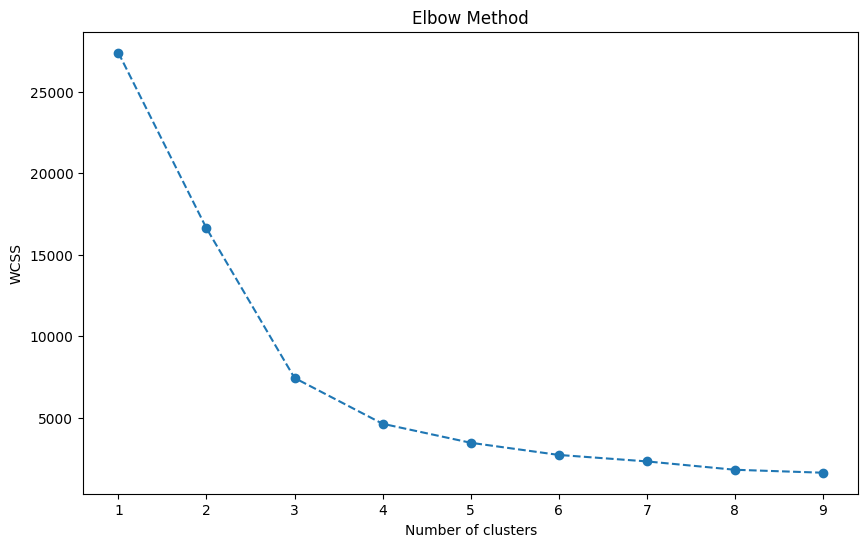

In [230]:
clustering(df[df['climbing_style']=='Boulder'].copy(), 5)

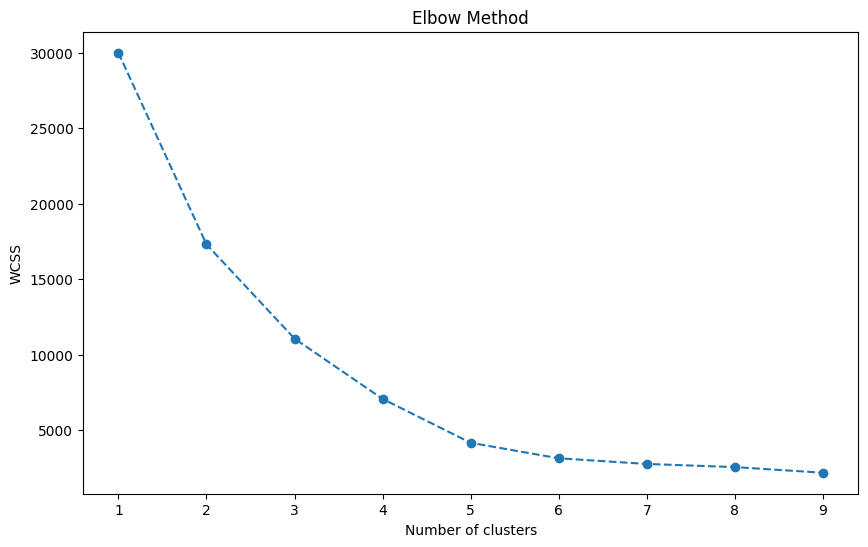

In [231]:
clustering(df[df['climbing_style']=='Lead'].copy(), 5)

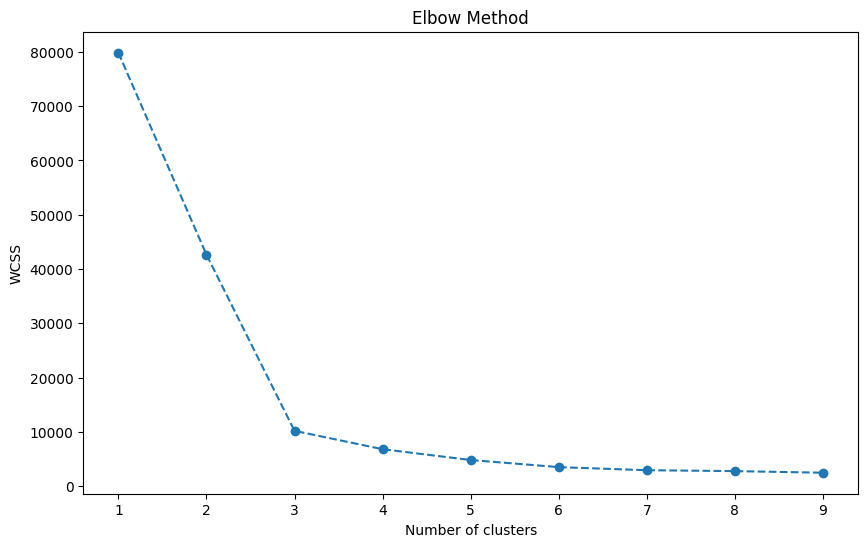

In [232]:
clustering(df.copy(), 3)